In [1]:
import json
import os

import cameratransform as ct
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from PIL.ExifTags import TAGS
from sklearn.metrics import mean_squared_error

In [2]:
%matplotlib inline
data_dir = r"./data/table"

# CameraTransform

## Introduction
TODO

## Loading the image
The image used for this tutorial is a picture of the table in my backyard. The dimensions of the table, the notebook and the candle holders are known.

In [3]:
# dimensions
table = (0.930, 1.435)  # w * h, m * m
candle = 0.095  # height in m
notebook = (0.22, 0.30)  # w * h, m * m

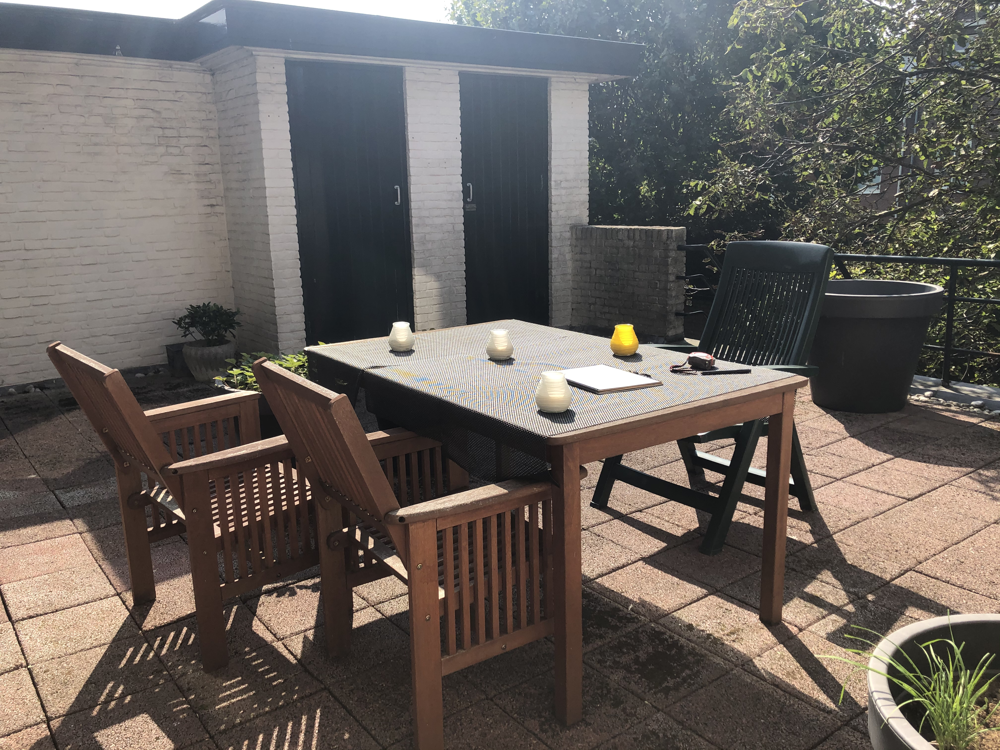

In [4]:
img_path = os.path.join(data_dir, "img_03.jpg")
img = Image.open(img_path)
img

In order to use the CameraTransform library, some _intrinsic_ camera qualities are required to be entered by the user:

* Focal length $f$, in mm
* Sensor size $w_{sensor}, h_{sensor}$, in mm
* Image size $w_{image}, h_{image}$, in pixels

Using PIL we can extract focal length and image size.

In [5]:
exifdata = img.getexif()
f = exifdata.get(37386)
image_size = img.size
print(f"Focal length = {f} mm \nImage size = {image_size[0]} * {image_size[1]} pixels")

Focal length = 3.99 mm 
Image size = 4032 * 3024 pixels


Sensor size is rarely given through Exif data, it can either be found on a look-up table, or be approximated using other variables.

Here, CameraTransform can help us. Simply enter the model name, and they searches a pre-existing look up table.

In [6]:
model = exifdata.get(272)
sensor_size = ct.camera._getSensorFromDatabase(model)
if sensor_size:
    print(f"{model} has a sensor size of {sensor_size} mm")
else: 
    print(f"{model}'s sensor size could not be found in database")

iPhone 8 Plus's sensor size could not be found in database


If the sensor size cannot be found in the Exif data or the database, it may be estimated.

Two methods have been implemented in order to estimate sensor size:

* Using FocalPlaneXResolution and FocalPlaneYResolution, and
* Using crop factor


FocalPlaneResolution:
$w_{sensor} = \dfrac{w_{image}}{X_{resolution}} \times 25.4\\
h_{sensor} = \dfrac{h_{image}}{Y_{resolution}} \times 25.4$

In [7]:
def sensor_size_focalresolution(resolution, image_size): 
    sensor_size = (image_size[0] / resolution[0] * 25.4,
                   image_size[1] / resolution[1] * 25.4)
    return sensor_size


resolution = exifdata.get(37390), exifdata.get(37391)
if resolution[0] is not None and resolution[1] is not None:
    sensor_size = sensor_size_focalresolution(resolution, image_size)

Crop factor:
$\textit{crop factor} = \dfrac{f_{\textbf{effective}}}{f_{\textbf{actual}}}\\
w_{sensor} = \dfrac{36}{\textit{crop factor}}\\
h_{sensor} = \dfrac{24}{\textit{crop factor}}
$

In [8]:
def sensor_size_crop_factor(effective_f: float, f: float):
    crop_factor = effective_f / f
    sensor_size = (36 / crop_factor, 24 / crop_factor)
    return sensor_size


effective_f = float(exifdata.get(41989))
if effective_f:
    sensor_size = sensor_size_crop_factor(effective_f, f)

In [9]:
print(f"{model} has a sensor size of {sensor_size} mm")

iPhone 8 Plus has a sensor size of (5.13, 3.4200000000000004) mm


I already know the sensor size for the iPhone 8 plus front camera:

In [10]:
sensor_size = (4.8, 3.5)

The sensor size estimated using crop factor is off by about 3 mm. While not exactly precise, it is a reasonable estimation.

All in all, that makes for the following variables:

In [11]:
print(f"Focal length = {f} mm", 
      f"Image size = {image_size[0]} * {image_size[1]} pixels",
      f"Sensor size = {sensor_size[0]} * {sensor_size[1]} mm", sep="\n")

Focal length = 3.99 mm
Image size = 4032 * 3024 pixels
Sensor size = 4.8 * 3.5 mm


## Initialising Camera
Now I have collected all the *intrinsic* camera qualities, I am able to initialise the camera object.

The first step is defining the type of projection. According to Gerum R. et al, a normal camera used Rectilinear projection:

In [12]:
proj = ct.RectilinearProjection(focallength_mm = f,
                                sensor = sensor_size,
                                image = image_size)

Optional;
The second step is initialising the spatial orientation. These are the *extrinsic* camera properties. Here we can enter our best guess before the "fitting" procedure is launched.

The following spatial parameters exist[^1]:

* `heading_deg`, $\alpha_{heading}$: the direction in which the camera is looking. (0°: the camera faces “north”, 90°: east, 180°: south, 270°: west)
* `tilt_deg`, $\alpha_{tilt}$: the tilt of the camera. (0°: camera faces down, 90°: camera faces parallel to the ground, 180°: camera faces upwards)
* `roll_deg`, $\alpha_{roll}$: the rotation of the image. (0°: camera image is not rotated (landscape format), 90°: camera image is in portrait format, 180°: camera is in upside down landscape format)
* `pos_x_m`, $x$: the x position of the camera.
* `pos_y_m`, $y$: the y position of the camera.
* `elevation_m`, $z$: the z position of the camera, or the elevation above the xy plane.

[^1] : Directly taken from https://cameratransform.readthedocs.io/en/latest/spatial.html

In [13]:
 # I am approximately 185 cm and the table is about 74 cm tall
space = ct.SpatialOrientation(elevation_m=1.85 - 0.74)

The final step is initialising the camera object with the projection and (optionally) the spatial orientation:

In [14]:
cam = ct.Camera(proj, space)

## Fitting from object height
In order for the camera to accurately estimate its *extrinsic* parameters, it needs certain reference objects. One of the techniques CameraTransform implements is "fitting via object height". Fitting via object height requires the following variables:
* Points feet, the coordinates of the bottoms of the objects
* Points head, the coordinates of the tops of the objects
* Height, the height(s) of the objects
* The standard deviation of the heights of the objects

### Selecting Heads and Feet
The first step is selecting the heads and feet using an annotation tool (I wrote my own with matplotlib):

In [15]:
def load_anno(json_fp=r"anno.json", arr_fp=r"anno.npz"):
    """Loads annotations from Annotator.save.

    :param json_fp: [description], defaults to r"anno.json"
    :type json_fp: regexp, optional
    :param arr_fp: [description], defaults to r"anno.npz"
    :type arr_fp: regexp, optional
    :return: [description]
    :rtype: [type]
    """
    with open(json_fp, "r") as fp:
        mappings = json.load(fp)

    with np.load(arr_fp) as arrs:
        anno_dict = {img: {"heads": arrs[f"{prefix}heads"],
                           "feet": arrs[f"{prefix}feet"]}
                     for img, prefix in mappings.items()}
    return anno_dict

json_fp = os.path.join(data_dir, "anno.json")
arr_fp = os.path.join(data_dir, "anno.npz")

anno_dict = load_anno(json_fp=json_fp, arr_fp=arr_fp)["D:\\University\\2020-2021\\Internship\\AssistanceTransform\\notebooks\\data\\table\\img_03.jpg"]

# Accidentally labeled in wrong order, corrected
feet, heads = anno_dict["heads"], anno_dict["feet"]

anno_dict

{'heads': array([[1611.98571164, 1413.95741237],
        [2011.50480903, 1445.91894016],
        [2518.8940627 , 1429.93817627],
        [2227.24512161, 1657.66406178]]),
 'feet': array([[1615.98090262, 1310.08244705],
        [2011.50480903, 1338.04878387],
        [2510.90368075, 1318.072829  ],
        [2227.24512161, 1513.83718672]])}

The following points have been selected:

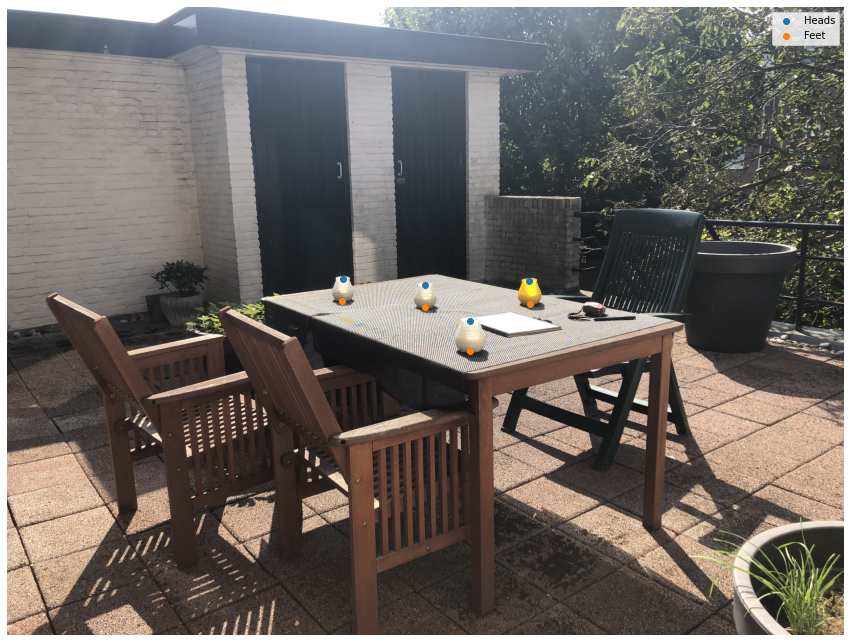

In [16]:
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111)
ax.imshow(img)
ax.scatter(heads[:,0], heads[:,1], label="Heads")
ax.scatter(feet[:,0], feet[:,1], label="Feet")
ax.axis("off")
ax.legend()
plt.show()

### Adding objects to Camera
The second step is figuring out the height and standard deviation of the measured objects. In this case, we know that a candle holder is about 9.5 centimeters tall. Due to the possibility of measuring and labeling errors, I think a STD of 1 centimeter would be adequate.

In [17]:
# Variation of actual object height is practically zero, 
# but due to measurement and labeleing errors, a variation of 0.01 will be used.
cam.addObjectHeightInformation(feet, heads, height=candle, variation=0.01)

### Fitting
The final step is fitting. In this step, you chose the parameters for which you will fit. I am not interested in the `X` or `Y` position of the camera. Other than those, I'll be fitting for all other parameters.

We've already guessed the elevation of the camera at `Initialising the camera`. This will be the starting value for `elevation_m`. The lower bound is 0: the camera is, at the very least, on the same `z` position as the candle holders (`z = 0`).

The upper bound I've set a bit generous: the maximum height of my arms somewhat exaggerated at 2 meters.

The final hyperparameters I need to set is the amount of iterations: a larger amount of iterations indicates a greater accuracy. `1e4` iterations takes about 5 seconds on my machine, `1e5` takes about 50 seconds. 

In [18]:
trace = cam.metropolis([
        ct.FitParameter("elevation_m", lower=0, upper=2, value=cam.elevation_m),
        ct.FitParameter("tilt_deg", lower=0, upper=180, value=80),
        ct.FitParameter("heading_deg", lower=-180, upper=180, value=-77),
        ct.FitParameter("roll_deg", lower=-180, upper=180, value=0)
        ], iterations=1e5)

C:\Users\Caspe\Anaconda3\envs\detectron\lib\site-packages\cameratransform\camera.py:952: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  given = np.array([X, Y, Z])
100%|██████████████████████████████████████████| 100000/100000 [00:52<00:00, 1914.95it/s, acc_rate=0.313, factor=0.154]


       elevation_m  tilt_deg  heading_deg   roll_deg  probability
0         0.747458  73.07701   -71.485032   1.435028    14.460036
1         0.747458  73.07701   -71.485032   1.435028    14.460036
2         0.747458  73.07701   -71.485032   1.435028    14.460036
3         0.747458  73.07701   -71.485032   1.435028    14.460036
4         0.747458  73.07701   -71.485032   1.435028    14.460036
...            ...       ...          ...        ...          ...
89994     0.688707  74.11117   -47.743223  12.386778    12.786758
89995     0.688707  74.11117   -47.743223  12.386778    12.786758
89996     0.688707  74.11117   -47.743223  12.386778    12.786758
89997     0.688707  74.11117   -47.743223  12.386778    12.786758
89998     0.688707  74.11117   -47.743223  12.386778    12.786758

[89999 rows x 5 columns]


## Transforming
The final step using CameraTransform is transforming image-coordinates to real-world coordinates. Transforming real-world coordinates (`3d`) to image-coordinates (`2d`) equals losing a dimensionality. This data loss means that the transformation from image-coordinates to real-world coordinates may have multiple correct answers. In order to correct for this, CameraTransform asks you to input one of the following:

* `X`, x-position of points in real-world
* `Y`, y-position of points in real-world
* `Z`, z-position of points in real-world (elevation)
* `D`, distance from camera

The standard argument is `Z=0`, the point you're trying to find is not elevated (in comparison to the reference objects). This works fine for this image.

### Selecting points to transform
The following points have been selected to transform:

* The four visible edges of the tabletop
* The three visible edges of the notebook

In [19]:
table_image = np.array([[1216, 1398], [2215, 1754], [3268, 1530], [2067, 1282]])

notebook_image = np.array([[2423, 1470], [2662, 1538], [2417, 1570]])

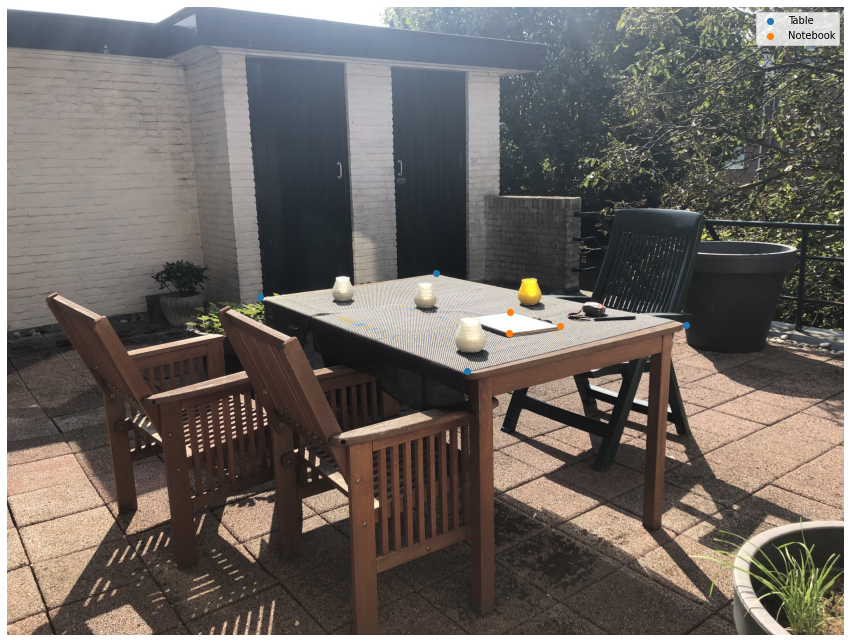

In [20]:
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111)
ax.imshow(img)
ax.scatter(*table_image.T, label="Table")
ax.scatter(*notebook_image.T, label="Notebook")
ax.axis("off")
ax.legend()
plt.show()

### Transforming
The final step to this proces is executing the function `Camera.spaceFromImage`. Simply enter the points you're trying to transform in (assuming the real objects are at `Z=0`).

In [21]:
table_real = cam.spaceFromImage(table_image)
table_real

array([[-3.05284237,  1.07154533,  0.        ],
       [-1.51224489,  1.11047563,  0.        ],
       [-1.47578469,  2.02383285,  0.        ],
       [-3.06530465,  2.06026192,  0.        ]])

In [22]:
notebook_real = cam.spaceFromImage(notebook_image)
notebook_real

array([[-2.03686967,  1.70886789,  0.        ],
       [-1.73967961,  1.68485152,  0.        ],
       [-1.78074388,  1.4879354 ,  0.        ]])

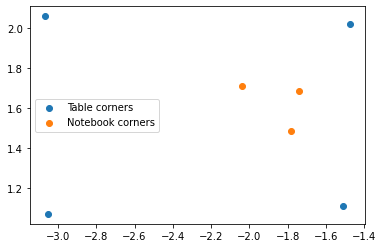

In [23]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(*table_real[:,:2].T, label="Table corners")
ax.scatter(*notebook_real[:,:2].T, label="Notebook corners")
ax.legend()
plt.show()

# Please note the switched axes

The points above have, at the very least, the correct ratio between them.

## Testing
To test the accuracy of this method, I will be comparing the distances between points.
### Distances between transformed points

First off the table:

In [24]:
table_bot_left = table_real[0]
table_bot_right = table_real[1]
table_top_right = table_real[2]
table_top_left = table_real[3]

In [25]:
table_width = (np.linalg.norm(table_bot_left - table_top_left), np.linalg.norm(table_bot_right- table_top_right))
table_length = (np.linalg.norm(table_bot_left - table_bot_right), np.linalg.norm(table_top_left - table_top_right))
print(f"Width values:  {table_width} vs. real width: {table[0]}",
      f"Length values: {table_length} vs. real length: {table[1]}", sep="\n")

Width values:  (0.9887951326339965, 0.9140846580938865) vs. real width: 0.93
Length values: (1.541089273325617, 1.5899373540846324) vs. real length: 1.435


Second, the notebook:

In [26]:
note_top_left  = notebook_real[0]
note_top_right = notebook_real[1]
note_bot_right = notebook_real[2]

In [27]:
note_width = (np.linalg.norm(note_top_right - note_bot_right), )
note_length = (np.linalg.norm(note_top_left - note_top_right), )
print(f"Width values:  {note_width} vs. real width: {notebook[0]}",
      f"Length values: {note_length} vs. real length: {notebook[1]}", sep="\n")

Width values:  (0.20115225581440774,) vs. real width: 0.22
Length values: (0.29815887949892156,) vs. real length: 0.3


### RMSE
RMSE is a good metric

In [28]:
table_true = (table[0], table[0], table[1], table[1])
# For only table
print(f"Table only RMSE: {mean_squared_error(table_true, table_width + table_length, squared=False)} m")


# For notebook only
print(f"Notebook only RMSE: {mean_squared_error(notebook, note_width + note_length, squared=False)} m")

# For both
rmse = mean_squared_error(table_true + notebook, table_width + table_length + note_width + note_length, squared=False)
print(f"Total RMSE: {rmse} m")

Table only RMSE: 0.09870496863752849 m
Notebook only RMSE: 0.013390802544750972 m
Total RMSE: 0.08096224482284624 m


### Results
An RMSE of only 7+-2 centimeters is totally acceptable, especially as the labeling of the notebook was not very accurate (it is a small image). According to Gerum R. et al, the accuracy of the model increases with more reference objects.